In [1]:
import torch
import torchvision
print(torch.__version__)
print(torchvision.__version__)
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print("Device:", device)




2.6.0+cu124
0.21.0+cu124
Device: cuda


In [6]:
import json
import os
import shutil
from sklearn.model_selection import train_test_split

dataset_dir = '/kaggle/input/patches-dectree/'  # original read-only input folder
working_dir = '/kaggle/working/patches_dectree/'  # writable folder

# Load COCO annotations
with open(os.path.join(dataset_dir, 'coco_annotations.json')) as f:
    coco = json.load(f)

image_ids = [img['id'] for img in coco['images']]

train_ids, test_ids = train_test_split(image_ids, test_size=0.3, random_state=42)
val_ids, test_ids = train_test_split(test_ids, test_size=0.5, random_state=42)

print(f"Train: {len(train_ids)}, Val: {len(val_ids)}, Test: {len(test_ids)}")

def create_subset_json(image_ids_subset, full_coco, out_json_path):
    images_subset = [img for img in full_coco['images'] if img['id'] in image_ids_subset]
    image_id_set = set(image_ids_subset)
    annotations_subset = [ann for ann in full_coco['annotations'] if ann['image_id'] in image_id_set]
    
    subset = {
        'images': images_subset,
        'annotations': annotations_subset,
        'categories': full_coco['categories']
    }
    
    with open(out_json_path, 'w') as f:
        json.dump(subset, f)
    print(f"Saved {out_json_path}")

# Create writable folders
for split in ['train', 'val', 'test']:
    os.makedirs(os.path.join(working_dir, split), exist_ok=True)

def copy_images(image_ids_subset, src_dir, dest_dir, coco):
    id_to_file = {img['id']: img['file_name'] for img in coco['images']}
    for img_id in image_ids_subset:
        src_path = os.path.join(src_dir, id_to_file[img_id])
        dst_path = os.path.join(dest_dir, id_to_file[img_id])
        if os.path.exists(src_path):
            shutil.copy(src_path, dst_path)  # copy instead of move

train_dir = os.path.join(working_dir, 'train')
val_dir = os.path.join(working_dir, 'val')
test_dir = os.path.join(working_dir, 'test')

copy_images(train_ids, dataset_dir, train_dir, coco)
copy_images(val_ids, dataset_dir, val_dir, coco)
copy_images(test_ids, dataset_dir, test_dir, coco)

create_subset_json(train_ids, coco, os.path.join(working_dir, 'coco_annotations_train.json'))
create_subset_json(val_ids, coco, os.path.join(working_dir, 'coco_annotations_val.json'))
create_subset_json(test_ids, coco, os.path.join(working_dir, 'coco_annotations_test.json'))


Train: 259, Val: 56, Test: 56
Saved /kaggle/working/patches_dectree/coco_annotations_train.json
Saved /kaggle/working/patches_dectree/coco_annotations_val.json
Saved /kaggle/working/patches_dectree/coco_annotations_test.json


In [19]:
import os
import json
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import torchvision.transforms as T
import numpy as np
from pycocotools import mask as mask_utils

class ApricotTreeDataset(Dataset):
    def __init__(self, root, annotation_file, transforms=None):
        self.root = root
        self.transforms = transforms

        # Load COCO annotations
        with open(annotation_file) as f:
            coco = json.load(f)
        
        self.imgs = coco['images']
        self.anns = coco['annotations']
        self.categories = coco['categories']

        # Map image_id to list of annotations
        self.imgid_to_anns = {}
        for ann in self.anns:
            self.imgid_to_anns.setdefault(ann['image_id'], []).append(ann)

        # Map image_id to filename
        self.imgid_to_filename = {img['id']: img['file_name'] for img in self.imgs}
        self.imgid_to_size = {img['id']: (img['height'], img['width']) for img in self.imgs}

    def __len__(self):
        return len(self.imgs)

    def __getitem__(self, idx):
        img_info = self.imgs[idx]
        img_id = img_info['id']
        img_path = os.path.join(self.root, img_info['file_name'])
        img = Image.open(img_path).convert("RGB")

        anns = self.imgid_to_anns.get(img_id, [])
        height, width = self.imgid_to_size[img_id]

        boxes = []
        labels = []
        masks = []

        for ann in anns:
            x, y, w, h = ann['bbox']
            boxes.append([x, y, x + w, y + h])
            labels.append(ann['category_id'])

            segmentation = ann['segmentation']
            rles = mask_utils.frPyObjects(segmentation, height, width)
            rle = mask_utils.merge(rles)
            mask = mask_utils.decode(rle)  # shape: (H, W, 1) or (H, W)
            if mask.ndim == 3:
                mask = mask[:, :, 0]  # squeeze channel
            masks.append(mask)

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        masks = torch.as_tensor(np.stack(masks), dtype=torch.uint8)
        image_id = torch.tensor([img_id])

        target = {
            "boxes": boxes,
            "labels": labels,
            "masks": masks,
            "image_id": image_id
        }

        if self.transforms:
            img, target = self.transforms(img, target)

        return img, target


In [20]:
class ComposeTransforms:
    def __init__(self, transforms):
        self.transforms = transforms

    def __call__(self, image, target):
        for t in self.transforms:
            image, target = t(image, target)
        return image, target

class ToTensor:
    def __call__(self, image, target):
        image = T.functional.to_tensor(image)
        return image, target

def get_transform(train):
    transforms = [ToTensor()]
    return ComposeTransforms(transforms)


In [21]:
dataset_root = "/kaggle/working/patches_dectree/train"
annotation_file = "/kaggle/working/patches_dectree/coco_annotations_train.json"

dataset = ApricotTreeDataset(dataset_root, annotation_file, transforms=get_transform(train=True))

train_loader = DataLoader(dataset, batch_size=4, shuffle=True, collate_fn=lambda x: tuple(zip(*x)))

# Check batch
imgs, targets = next(iter(train_loader))
print("Keys in target:", targets[0].keys())
print("Mask shape:", targets[0]["masks"].shape)


Keys in target: dict_keys(['boxes', 'labels', 'masks', 'image_id'])
Mask shape: torch.Size([1, 512, 512])


In [22]:
val_root = "/kaggle/working/patches_dectree/val"  # update as per your split folder
val_annotation_file = "/kaggle/working/patches_dectree/coco_annotations_val.json"  # update accordingly
test_root = "/kaggle/working/patches_dectree/test"  # update as per your split folder
test_annotation_file = "/kaggle/working/patches_dectree/coco_annotations_test.json"  # update accordingly

val_dataset = ApricotTreeDataset(val_root, val_annotation_file, transforms=get_transform(train=False))
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))

test_dataset = ApricotTreeDataset(test_root, test_annotation_file, transforms=get_transform(train=False))
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, collate_fn=lambda x: tuple(zip(*x)))


In [23]:
def verify_loader(loader, name):
    imgs, targets = next(iter(loader))
    print(f"{name} loader batch size: {len(imgs)}")
    print(f"{name} target keys: {targets[0].keys()}")
    print(f"{name} sample boxes: {targets[0]['boxes']}")

# Assuming you created loaders:
# train_loader, val_loader, test_loader

verify_loader(train_loader, "Train")
verify_loader(val_loader, "Val")
verify_loader(test_loader, "Test")


Train loader batch size: 4
Train target keys: dict_keys(['boxes', 'labels', 'masks', 'image_id'])
Train sample boxes: tensor([[104., 112., 408., 401.]])
Val loader batch size: 4
Val target keys: dict_keys(['boxes', 'labels', 'masks', 'image_id'])
Val sample boxes: tensor([[122., 118., 391., 394.]])
Test loader batch size: 4
Test target keys: dict_keys(['boxes', 'labels', 'masks', 'image_id'])
Test sample boxes: tensor([[ 17.,  75., 496., 438.]])


In [24]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

# Load pretrained Mask R-CNN
model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

# Number of classes: background + tree = 2
num_classes = 2

# Replace the box predictor (for classification and bbox regression)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

# Replace the mask predictor
in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
hidden_layer = 256
model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask, hidden_layer, num_classes)

print("Model loaded and adapted for 2 classes (background + tree)")


Model loaded and adapted for 2 classes (background + tree)


In [25]:
for name, parameter in model.backbone.body.named_parameters():
    parameter.requires_grad = False

print("Backbone layers frozen. Only ROI heads will be trained.")


Backbone layers frozen. Only ROI heads will be trained.


In [26]:
import torch

# Only parameters that require gradients (ROI heads)
params = [p for p in model.parameters() if p.requires_grad]

# Define optimizer
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# Learning rate scheduler (decay LR by 0.1 every 3 epochs)
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

print("Optimizer and LR scheduler are ready.")


Optimizer and LR scheduler are ready.


In [27]:
import torch

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)
model.train()

for images, targets in train_loader:
    images = list(img.to(device) for img in images)
    targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

    loss_dict = model(images, targets)
    losses = sum(loss for loss in loss_dict.values())

    optimizer.zero_grad()
    losses.backward()
    optimizer.step()

    print(f"Training batch loss: {losses.item():.4f}")
    break  # Remove break to run full epoch


Training batch loss: 2.4672


In [31]:

import torch
import os
import zipfile

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

num_epochs = 10
# Use Kaggle working dir for saving checkpoints (persistent during session)
checkpoint_dir = '/kaggle/working/checkpoints'
os.makedirs(checkpoint_dir, exist_ok=True)

for epoch in range(num_epochs):
    # Training
    model.train()
    train_loss = 0
    for images, targets in train_loader:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        train_loss += losses.item()

    train_loss /= len(train_loader)
    print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}")

    # Validation
    model.eval()
    with torch.no_grad():
        val_loss = 0
        for images, targets in val_loader:
            images = [img.to(device) for img in images]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

            model.train()
            loss_dict = model(images, targets)
            losses = sum(loss for loss in loss_dict.values())
            val_loss += losses.item()
            model.eval()

        val_loss /= len(val_loader)
        print(f"Epoch [{epoch+1}/{num_epochs}], Validation Loss: {val_loss:.4f}")

    # Save checkpoint to persistent path
    checkpoint_path = os.path.join(checkpoint_dir, f'model_epoch_{epoch+1}.pth')
    torch.save({
        'epoch': epoch + 1,
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'lr_scheduler_state_dict': lr_scheduler.state_dict(),
    }, checkpoint_path)
    print(f"Saved checkpoint: {checkpoint_path}")

# Zip all checkpoints into /kaggle/working so you can download it easily
zip_path = '/kaggle/working/checkpoints.zip'
with zipfile.ZipFile(zip_path, 'w') as zipf:
    for file_name in os.listdir(checkpoint_dir):
        full_path = os.path.join(checkpoint_dir, file_name)
        zipf.write(full_path, arcname=file_name)
print(f"All checkpoints zipped into: {zip_path}")

# Save latest checkpoint path to text file for easy loading
latest_ckpt_path = os.path.join(checkpoint_dir, f'model_epoch_{num_epochs}.pth')
with open('/kaggle/working/latest_checkpoint.txt', 'w') as f:
    f.write(latest_ckpt_path)
print(f"Latest checkpoint path saved in /kaggle/working/latest_checkpoint.txt")


Epoch [1/10], Train Loss: 0.3069
Epoch [1/10], Validation Loss: 0.3636
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_1.pth
Epoch [2/10], Train Loss: 0.2920
Epoch [2/10], Validation Loss: 0.3971
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_2.pth
Epoch [3/10], Train Loss: 0.2865
Epoch [3/10], Validation Loss: 0.3674
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_3.pth
Epoch [4/10], Train Loss: 0.2782
Epoch [4/10], Validation Loss: 0.3625
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_4.pth
Epoch [5/10], Train Loss: 0.2610
Epoch [5/10], Validation Loss: 0.3760
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_5.pth
Epoch [6/10], Train Loss: 0.2488
Epoch [6/10], Validation Loss: 0.3643
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_6.pth
Epoch [7/10], Train Loss: 0.2426
Epoch [7/10], Validation Loss: 0.3616
Saved checkpoint: /kaggle/working/checkpoints/model_epoch_7.pth
Epoch [8/10], Train Loss: 0.2374
Epoch [8/10], Validati

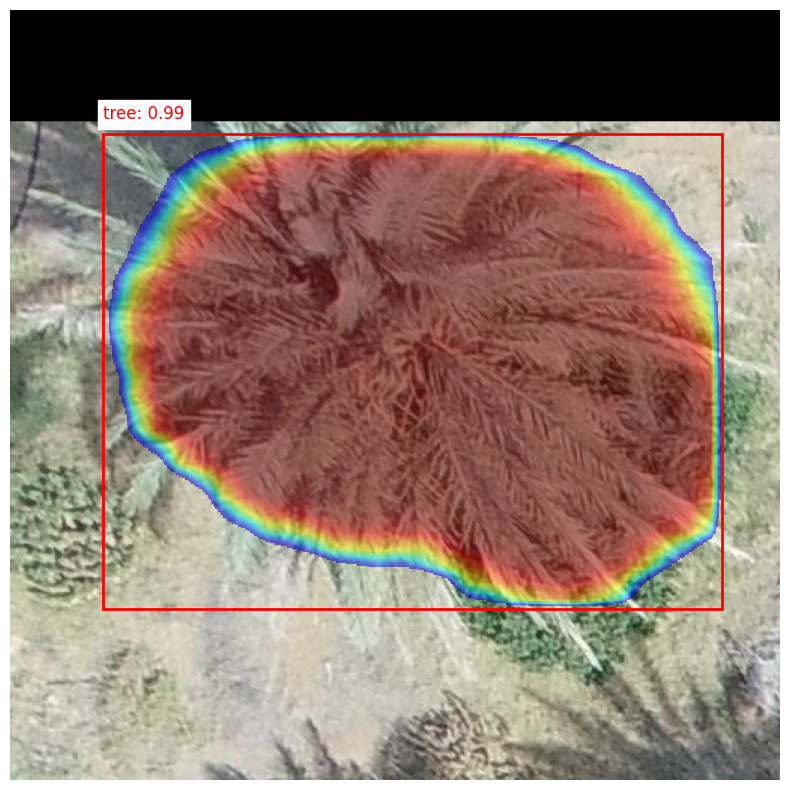

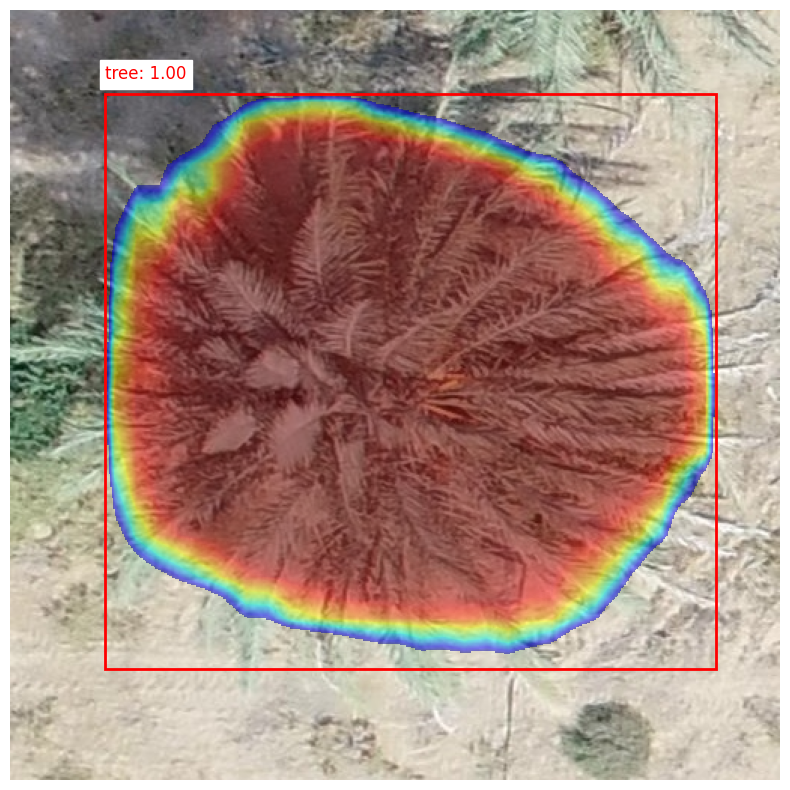

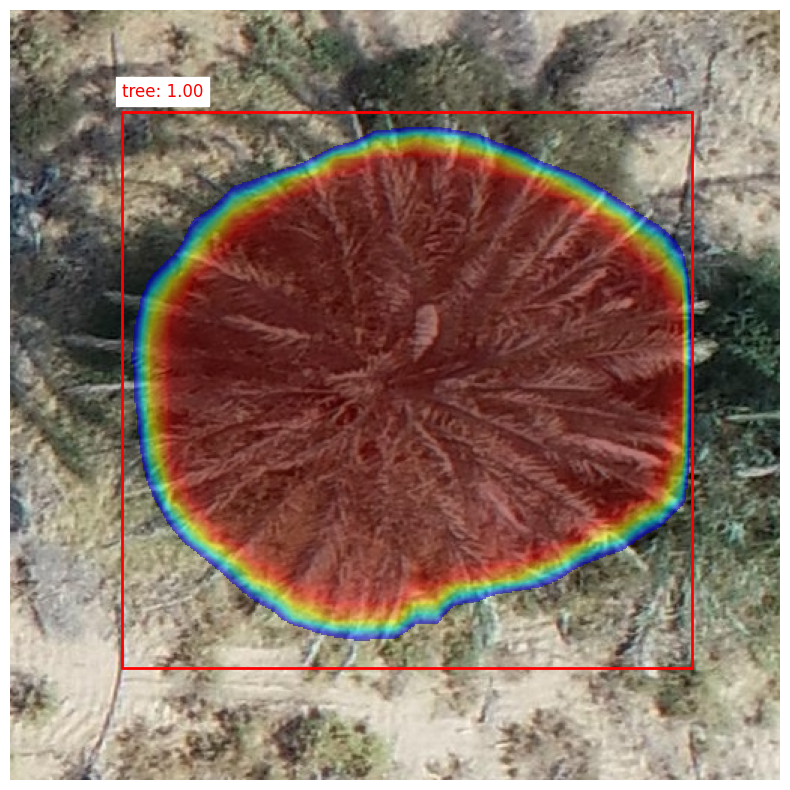

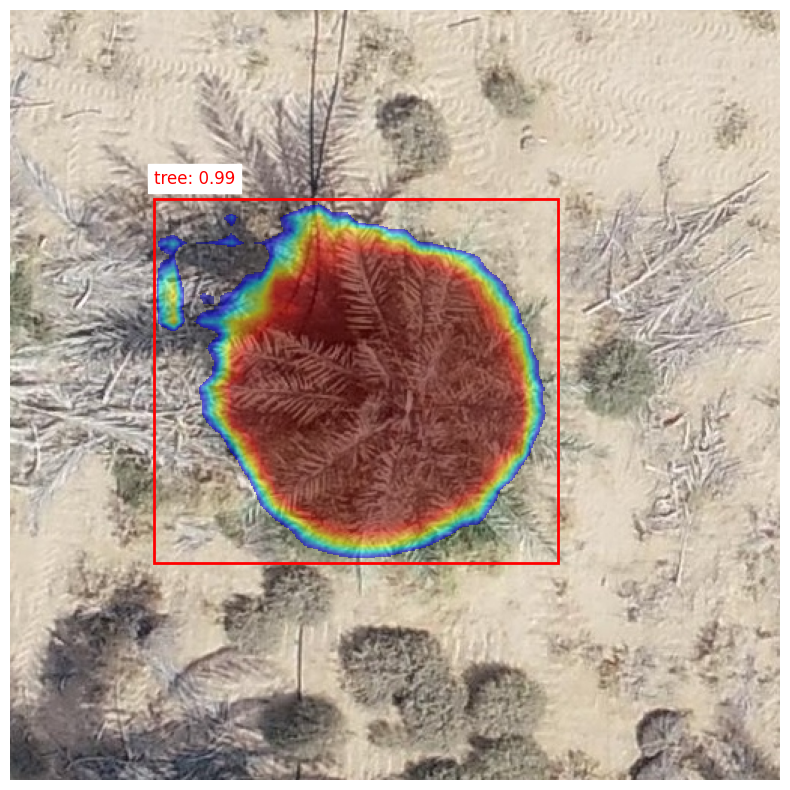

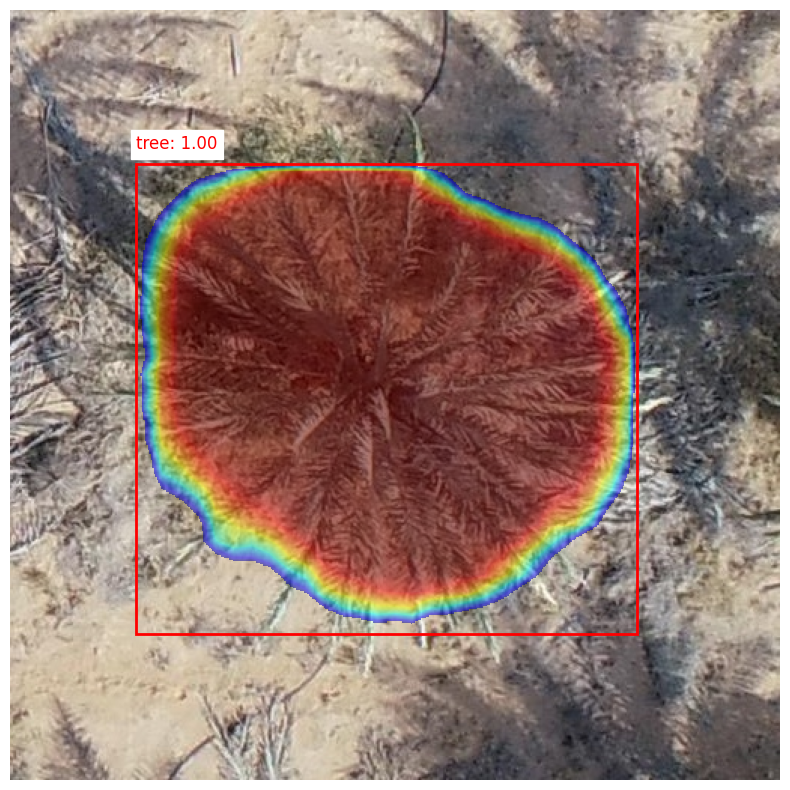

...

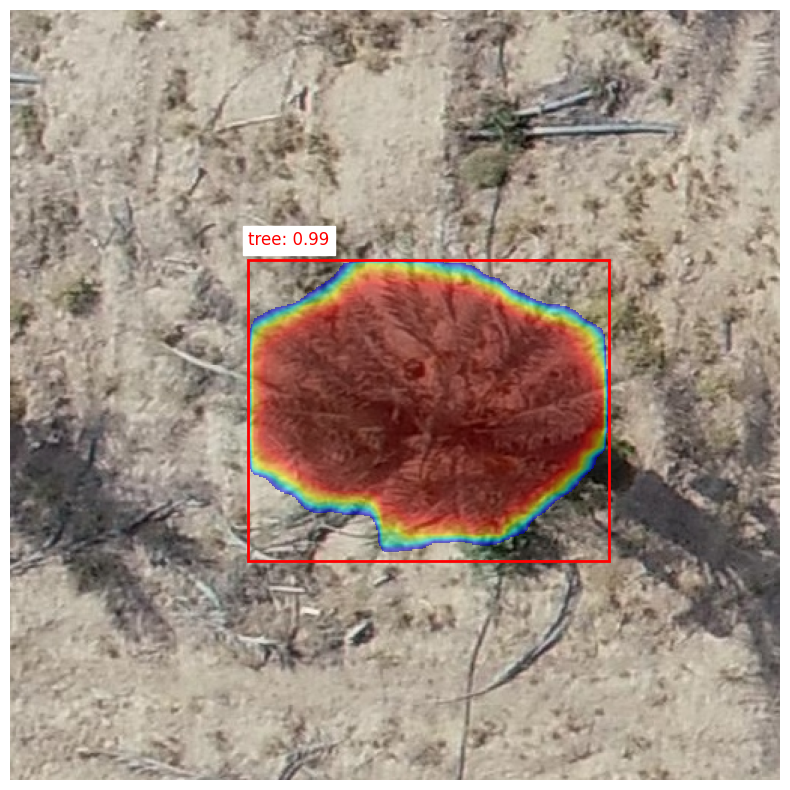

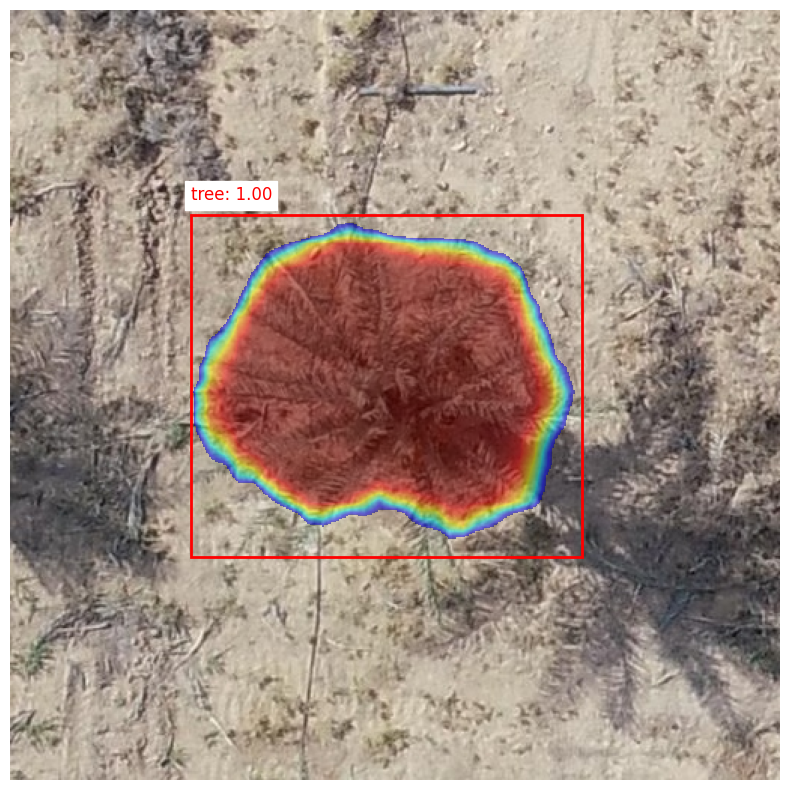

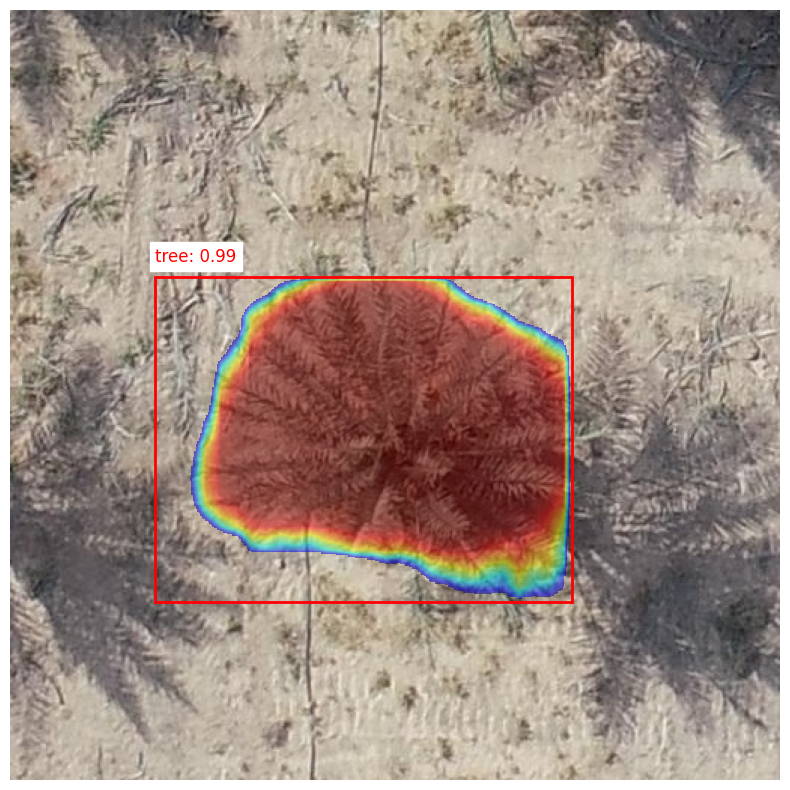

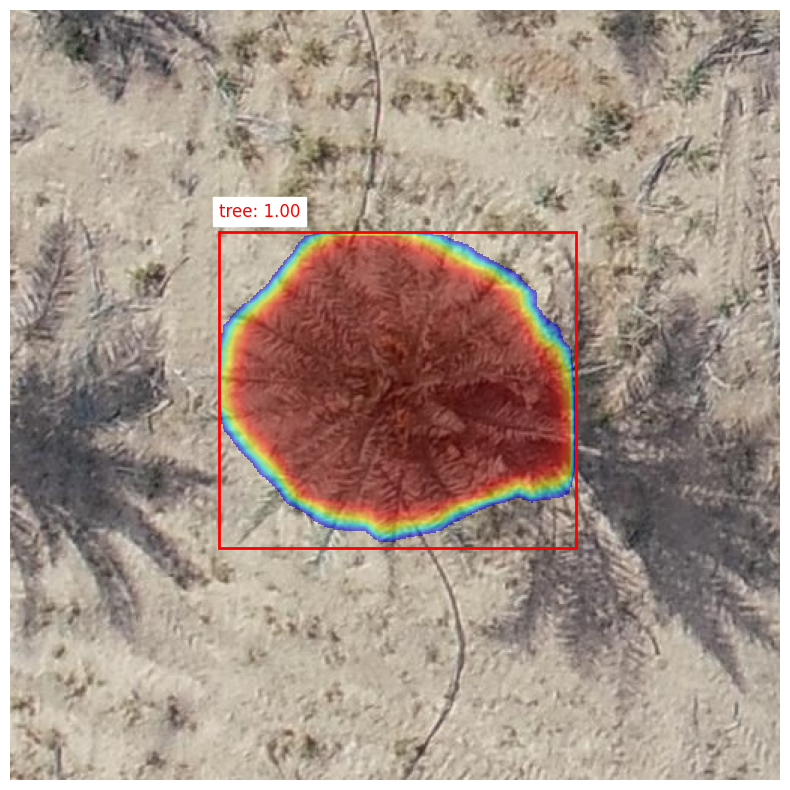

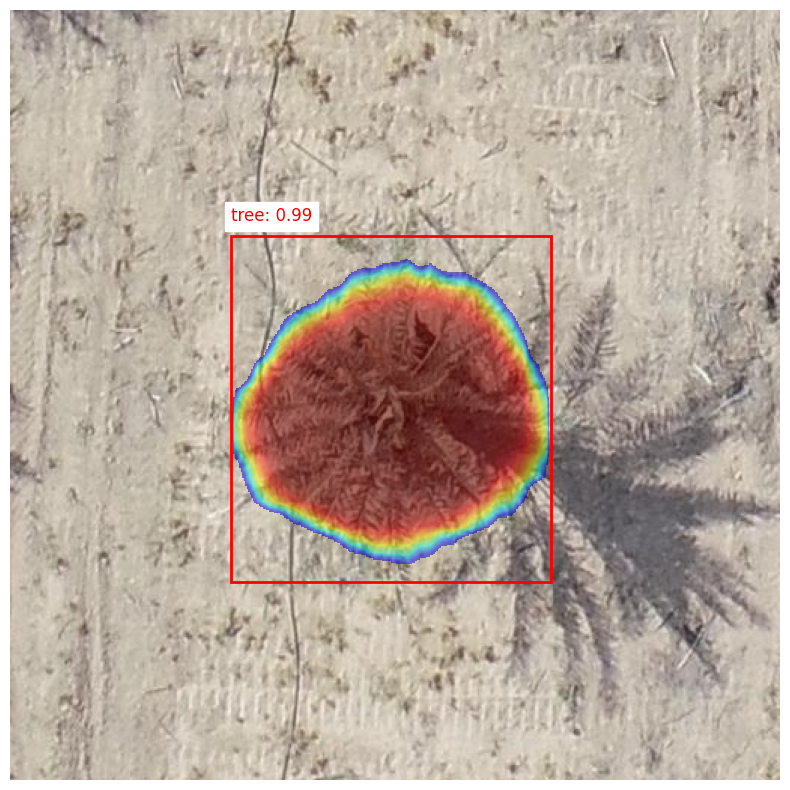

In [32]:
import torch
import matplotlib.pyplot as plt
import torchvision.transforms.functional as F
import numpy as np

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)
model.eval()

# Category names, 1 = tree, 0 = background (adjust if more classes)
COCO_INSTANCE_CATEGORY_NAMES = ['__background__', 'tree']

def visualize_predictions(image, prediction, threshold=0.5):
    """
    image: PIL Image
    prediction: output dict from Mask R-CNN with keys 'boxes', 'labels', 'scores', 'masks'
    threshold: confidence threshold to filter predictions
    """
    img = np.array(image)
    plt.figure(figsize=(10, 10))
    plt.imshow(img)

    boxes = prediction['boxes'].cpu().detach().numpy()
    scores = prediction['scores'].cpu().detach().numpy()
    labels = prediction['labels'].cpu().detach().numpy()
    masks = prediction['masks'].cpu().detach().numpy()

    for i, score in enumerate(scores):
        if score < threshold:
            continue
        
        box = boxes[i]
        label = labels[i]
        mask = masks[i, 0]

        # Draw bounding box
        plt.gca().add_patch(plt.Rectangle((box[0], box[1]), box[2]-box[0], box[3]-box[1],
                                          fill=False, edgecolor='red', linewidth=2))
        plt.text(box[0], box[1]-10, f"{COCO_INSTANCE_CATEGORY_NAMES[label]}: {score:.2f}",
                 color='red', fontsize=12, backgroundcolor='white')

        # Overlay mask with transparency
        masked = np.ma.masked_where(mask < 0.5, mask)
        plt.imshow(masked, alpha=0.5, cmap='jet')

    plt.axis('off')
    plt.show()

# Run inference and visualize on few test images
num_images_to_show = 5

with torch.no_grad():
    for i, (images, targets) in enumerate(test_loader):
        images = list(img.to(device) for img in images)
        
        outputs = model(images)

        # Convert tensor image back to PIL for visualization
        for img_tensor, pred in zip(images, outputs):
            img = F.to_pil_image(img_tensor.cpu())
            visualize_predictions(img, pred, threshold=0.5)
        
        if i+1 >= num_images_to_show:
            break


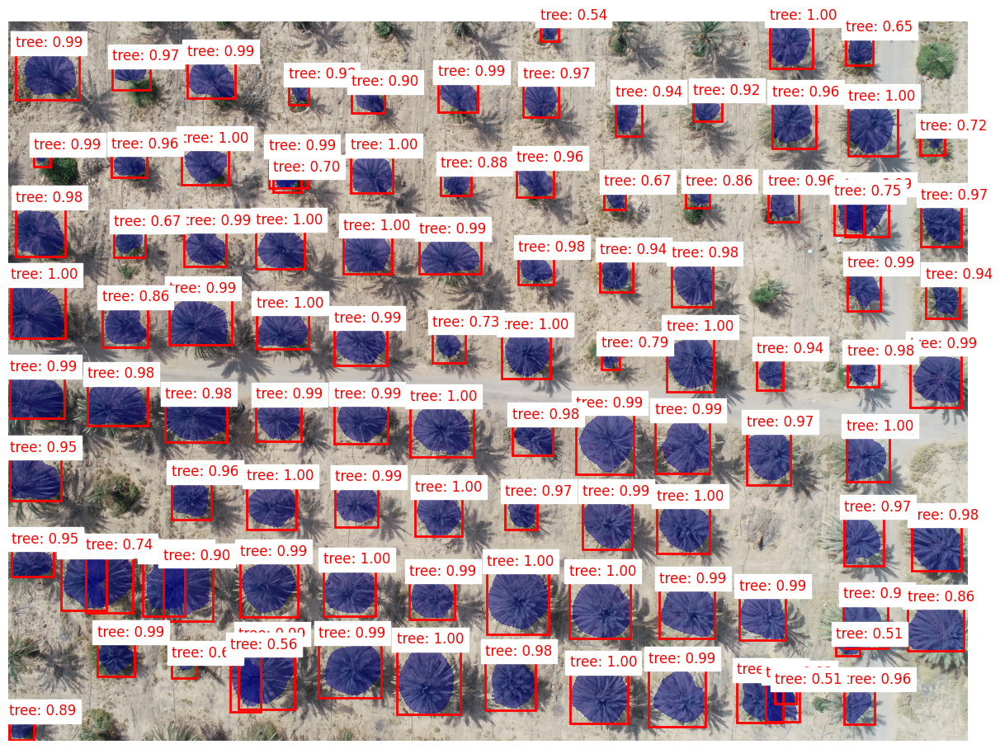

In [33]:
import torch
import numpy as np
from PIL import Image
import torchvision.transforms.functional as F
from torchvision.ops import nms
import matplotlib.pyplot as plt

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)
model.eval()

def get_patches(image, patch_size=512, overlap=128):
    """
    Cut large PIL image into overlapping patches.
    Returns list of (patch_img, (x_offset, y_offset))
    """
    width, height = image.size
    stride = patch_size - overlap
    patches = []

    for y in range(0, height, stride):
        for x in range(0, width, stride):
            # Make sure patch within image boundary
            x_end = min(x + patch_size, width)
            y_end = min(y + patch_size, height)
            x_start = max(x_end - patch_size, 0)
            y_start = max(y_end - patch_size, 0)

            patch = image.crop((x_start, y_start, x_end, y_end))
            patches.append((patch, (x_start, y_start)))
    return patches

def run_inference_on_big_image(big_image, threshold=0.5):
    patch_size = 512
    overlap = 128
    patches = get_patches(big_image, patch_size, overlap)

    all_boxes = []
    all_labels = []
    all_scores = []
    all_masks = []

    with torch.no_grad():
        for patch_img, (x_off, y_off) in patches:
            img_tensor = F.to_tensor(patch_img).to(device)
            output = model([img_tensor])[0]

            # Filter predictions by score threshold
            scores = output['scores'].cpu()
            keep = scores >= threshold

            boxes = output['boxes'][keep].cpu()
            labels = output['labels'][keep].cpu()
            scores = scores[keep]
            masks = output['masks'][keep].cpu()

            # Shift boxes and masks to big image coordinates
            boxes += torch.tensor([x_off, y_off, x_off, y_off])
            
            # For masks, place them on full image sized mask
            # Resize masks to patch_size if needed (should be already patch size)
            for i, mask in enumerate(masks):
                full_mask = torch.zeros((big_image.height, big_image.width), dtype=torch.uint8)
                mask_bin = (mask[0] > 0.5).to(torch.uint8)
                full_mask[y_off:y_off+patch_size, x_off:x_off+patch_size] = mask_bin
                all_masks.append(full_mask)

            all_boxes.append(boxes)
            all_labels.append(labels)
            all_scores.append(scores)

    # Concat all patch detections
    all_boxes = torch.cat(all_boxes)
    all_labels = torch.cat(all_labels)
    all_scores = torch.cat(all_scores)
    all_masks = torch.stack(all_masks) if all_masks else torch.tensor([])

    # Apply NMS globally (on boxes only, threshold e.g. 0.3)
    keep_indices = nms(all_boxes, all_scores, iou_threshold=0.3)

    final_boxes = all_boxes[keep_indices]
    final_labels = all_labels[keep_indices]
    final_scores = all_scores[keep_indices]
    final_masks = all_masks[keep_indices] if all_masks.numel() > 0 else None

    return final_boxes, final_labels, final_scores, final_masks

def visualize_big_image_predictions(big_image, boxes, labels, scores, masks=None):
    img = np.array(big_image)
    plt.figure(figsize=(15, 15))
    plt.imshow(img)

    for i in range(len(boxes)):
        box = boxes[i].numpy()
        label = labels[i].item()
        score = scores[i].item()

        # Bounding box
        plt.gca().add_patch(
            plt.Rectangle((box[0], box[1]), box[2]-box[0], box[3]-box[1],
                          fill=False, edgecolor='red', linewidth=2)
        )
        plt.text(box[0], box[1]-10, f"tree: {score:.2f}",
                 color='red', fontsize=12, backgroundcolor='white')

        # Mask overlay
        if masks is not None:
            mask = masks[i].numpy()
            masked = np.ma.masked_where(mask == 0, mask)
            plt.imshow(masked, alpha=0.5, cmap='jet')

    plt.axis('off')
    plt.show()

# Usage example:

# Load your big orthophoto image
big_image_path = "/kaggle/input/testing-tree/tree mask5.jpg"
big_image = Image.open(big_image_path).convert("RGB")

boxes, labels, scores, masks = run_inference_on_big_image(big_image, threshold=0.5)

visualize_big_image_predictions(big_image, boxes, labels, scores, masks)
